### Imports

In [1]:
import pandas as pd
import numpy as np
import geopandas as gpd

In [2]:
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline 
mpl.rcParams['figure.dpi'] = 300

In [3]:
from sklearn.preprocessing import Normalizer

In [4]:
pd.options.display.max_rows = 4000
pd.options.display.max_columns = 4000

### Setup

In [5]:
DATA_VERSION = 'v4'

In [6]:
fig_dir = '../' + DATA_VERSION + '-fig/fig-cgis-no-eu/SCCS/'

In [7]:
cgi_csv = '../data/' + DATA_VERSION + '/institutions_data_prepped.csv'

In [8]:
cgi_df = pd.read_csv(cgi_csv)

In [9]:
cgi_df.head()

,Institution_Name,Community_Name,Mechanism,Notes,Time span,Geography,Size,Source,Heterogeneity,Time span: Start,Time span: End,SCCS,is_SCCS,decision_making_mechanisms_include_frequent_and_or_regular_meetings,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_council_central_,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_board_committee,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_bureaucracy,enforcement_mechanisms_include_fines,decision_making_mechanisms_include_plurality_voting,enforcement_mechanisms_include_criticism_mocking_joking,access_mechanisms_include_age_boundaries,access_mechanisms_include_popularity_,access_mechanisms_include_co-optation,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_autocratic_leader_chief_bound,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_destruction_of_property,access_mechanisms_include_heredity,access_mechanisms_include_matriarchy,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_forced_labour,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_petition,access_mechanisms_include_life_appointment,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_balance_of_power,enforcement_mechanisms_include_arbitration,access_mechanisms_include_screening_process,enforcement_mechanisms_include_self-help,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_delegation,access_mechanisms_include_dreaming,access_mechanisms_include_blood_relations,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_vote_by_show_of_hands,access_mechanisms_include_divine_right,decision_making_mechanisms_include_leader_first_among_equals,enforcement_mechanisms_include_scrutiny_of_officials,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_political_unit,access_mechanisms_include_meritocracy,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_remunerated_position,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_turnover_rotation,enforcement_mechanisms_include_paying_damages_compensation,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_voting,access_mechanisms_include_induction_rite_ceremony,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_group_voting,decision_making_mec

In [10]:
# Drop Region: Europe
cgi_df = cgi_df[cgi_df['Region: Europe'] != 1]
cgi_df['Region: Europe'].sum()

0

In [11]:
cgi_df.head()

,Institution_Name,Community_Name,Mechanism,Notes,Time span,Geography,Size,Source,Heterogeneity,Time span: Start,Time span: End,SCCS,is_SCCS,decision_making_mechanisms_include_frequent_and_or_regular_meetings,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_council_central_,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_board_committee,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_bureaucracy,enforcement_mechanisms_include_fines,decision_making_mechanisms_include_plurality_voting,enforcement_mechanisms_include_criticism_mocking_joking,access_mechanisms_include_age_boundaries,access_mechanisms_include_popularity_,access_mechanisms_include_co-optation,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_autocratic_leader_chief_bound,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_destruction_of_property,access_mechanisms_include_heredity,access_mechanisms_include_matriarchy,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_forced_labour,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_petition,access_mechanisms_include_life_appointment,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_balance_of_power,enforcement_mechanisms_include_arbitration,access_mechanisms_include_screening_process,enforcement_mechanisms_include_self-help,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_delegation,access_mechanisms_include_dreaming,access_mechanisms_include_blood_relations,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_vote_by_show_of_hands,access_mechanisms_include_divine_right,decision_making_mechanisms_include_leader_first_among_equals,enforcement_mechanisms_include_scrutiny_of_officials,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_political_unit,access_mechanisms_include_meritocracy,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_remunerated_position,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_turnover_rotation,enforcement_mechanisms_include_paying_damages_compensation,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_voting,access_mechanisms_include_induction_rite_ceremony,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_group_voting,decision_making_mec

Note: CGI -> CGI *mechanisms*

In [12]:
cgi_only_df = cgi_df[cgi_df['CGI'].notna()]

In [13]:
cgi_only_df.head()

,Institution_Name,Community_Name,Mechanism,Notes,Time span,Geography,Size,Source,Heterogeneity,Time span: Start,Time span: End,SCCS,is_SCCS,decision_making_mechanisms_include_frequent_and_or_regular_meetings,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_council_central_,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_board_committee,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_bureaucracy,enforcement_mechanisms_include_fines,decision_making_mechanisms_include_plurality_voting,enforcement_mechanisms_include_criticism_mocking_joking,access_mechanisms_include_age_boundaries,access_mechanisms_include_popularity_,access_mechanisms_include_co-optation,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_autocratic_leader_chief_bound,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_destruction_of_property,access_mechanisms_include_heredity,access_mechanisms_include_matriarchy,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_forced_labour,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_petition,access_mechanisms_include_life_appointment,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_balance_of_power,enforcement_mechanisms_include_arbitration,access_mechanisms_include_screening_process,enforcement_mechanisms_include_self-help,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_delegation,access_mechanisms_include_dreaming,access_mechanisms_include_blood_relations,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_vote_by_show_of_hands,access_mechanisms_include_divine_right,decision_making_mechanisms_include_leader_first_among_equals,enforcement_mechanisms_include_scrutiny_of_officials,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_political_unit,access_mechanisms_include_meritocracy,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_remunerated_position,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_turnover_rotation,enforcement_mechanisms_include_paying_damages_compensation,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_voting,access_mechanisms_include_induction_rite_ceremony,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_group_voting,decision_making_mec

In [14]:
cgi_mechanisms_list = [x for x in cgi_only_df.columns if 'cgis_include_' in x]
cgi_mechanisms_list

['enforcement_cgis_include_jury_judge',
 'access_cgis_include_election',
 'enforcement_cgis_include_tribunal_court_',
 'decision_making_cgis_include_temporary_position_of_power_term_limits',
 'enforcement_cgis_include_arbitration',
 'access_cgis_include_matrilineality',
 'access_cgis_include_age_boundaries',
 'decision_making_cgis_include_magistrate_official',
 'decision_making_cgis_include_deliberation',
 'decision_making_cgis_include_consensus',
 'enforcement_cgis_include_mediation',
 'enforcement_cgis_include_graduated_sanctions',
 'enforcement_cgis_include_capital_punishment',
 'access_cgis_include_co-optation',
 'decision_making_cgis_include_consultation',
 'access_cgis_include_heredity',
 'enforcement_cgis_include_suspension_expulsion_ostracism_proscription',
 'decision_making_cgis_include_consent',
 'decision_making_cgis_include_oath',
 'access_cgis_include_popularity_',
 'decision_making_cgis_include_quorum',
 'access_cgis_include_property_requirement',
 'decision_making_cgis_i

In [15]:
cgi_mechanisms_df = cgi_only_df[cgi_mechanisms_list]

In [16]:
cgi_mechanisms_df

,enforcement_cgis_include_jury_judge,access_cgis_include_election,enforcement_cgis_include_tribunal_court_,decision_making_cgis_include_temporary_position_of_power_term_limits,enforcement_cgis_include_arbitration,access_cgis_include_matrilineality,access_cgis_include_age_boundaries,decision_making_cgis_include_magistrate_official,decision_making_cgis_include_deliberation,decision_making_cgis_include_consensus,enforcement_cgis_include_mediation,enforcement_cgis_include_graduated_sanctions,enforcement_cgis_include_capital_punishment,access_cgis_include_co-optation,decision_making_cgis_include_consultation,access_cgis_include_heredity,enforcement_cgis_include_suspension_expulsion_ostracism_proscription,decision_making_cgis_include_consent,decision_making_cgis_include_oath,access_cgis_include_popularity_,decision_making_cgis_include_quorum,access_cgis_include_property_requirement,decision_making_cgis_include_veto,access_cgis_include_screening_process,access_cgis_include_patronage_for_office,decision_making_cgis_include_plurality_voting,enforcement_cgis_include_criticism_mocking_joking,decision_making_cgis_include_public_meetings,enforcement_cgis_include_litigation,decision_making_cgis_include_frequent_and_or_regular_meetings,decision_making_cgis_include_remunerated_position,access_cgis_include_child_participation,enforcement_cgis_include_negotiation,decision_making_cgis_include_council_local,decision_making_cgis_include_ratification_acclamation_only,decision_making_cgis_include_secret_ballot,decision_making_cgis_include_gathering,access_cgis_include_gerontocracy,decision_making_cgis_include_supermajority,enforcement_cgis_include_exit,decision_making_cgis_include_majority_voting,decision_making_cgis_include_group_voting,decision_making_cgis_include_vote_by_show_of_hands,access_cgis_include_matriarchy,decision_making_cgis_include_unanimity,decision_making_cgis_include_representation,decision_making_cgis_include_board_committee,enforcement_cgis_include_corporal_punishment_violence_against_perpetrator,access_cgis_include_payment_for_occupying_office,decision_making_cgis_include_assembly_central,access_cgis_include_lottery_random_selection,enforcement_cgis_include_appeal,decision_making_cgis_include_turnover_rotation,access_cgis_include_female_participation,decision_making_cgis_include_vote_by_proxy,decision_making_cgis_include_assembly_elite,decision_making_cgis_include_delegation,decision_making_cgis_include_voting,decision_making_cgis_include_council_central_,access_cgis_include_meritocracy,enforcement_cgis_include_judicial_review,decision_making_cgis_include_agenda_setting,decision_making_cgis_include_checks_and_balances,decision_making_cgis_include_assembly_local,enforcement_cgis_include_reputational_risk,enforcement_cgis_include_scrutiny_of_officials,access_cgis_include_blood_relations,enforcement_cgis_include_fines,access_cgis_include_life_appointment
10,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0
19,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
31,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
33,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
34,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
36,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
39,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
41,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,

In [17]:
cgi_mechanisms_df.sum().sort_values(ascending=False)

decision_making_cgis_include_council_central_                                44
decision_making_cgis_include_council_local                                   40
decision_making_cgis_include_deliberation                                    38
decision_making_cgis_include_consensus                                       26
decision_making_cgis_include_representation                                  24
access_cgis_include_gerontocracy                                             24
enforcement_cgis_include_tribunal_court_                                     20
access_cgis_include_election                                                 14
decision_making_cgis_include_gathering                                       13
decision_making_cgis_include_public_meetings                                 12
access_cgis_include_female_participation                                     12
decision_making_cgis_include_assembly_central                                10
access_cgis_include_meritocracy         

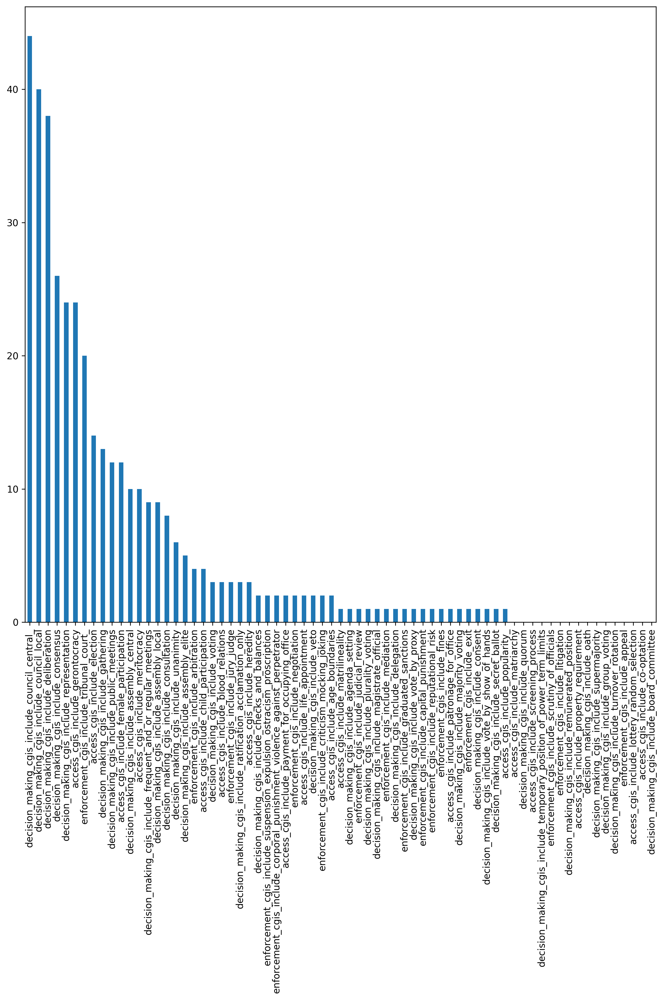

In [19]:
cgi_mechanisms_df.sum().sort_values(ascending=False).plot(kind='bar', figsize=(10,15))

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_histogram.png')
plt.show()

TODO: 
  - comparative analysis b/n CGI mechanisms and non-CGI mechanisms

## By Mechanism category

In [20]:
access_cgis = [x for x in cgi_df.columns if 'access_cgis_' in x]

In [21]:
cgi_df[access_cgis]

,access_cgis_include_election,access_cgis_include_matrilineality,access_cgis_include_age_boundaries,access_cgis_include_co-optation,access_cgis_include_heredity,access_cgis_include_popularity_,access_cgis_include_property_requirement,access_cgis_include_screening_process,access_cgis_include_patronage_for_office,access_cgis_include_child_participation,access_cgis_include_gerontocracy,access_cgis_include_matriarchy,access_cgis_include_payment_for_occupying_office,access_cgis_include_lottery_random_selection,access_cgis_include_female_participation,access_cgis_include_meritocracy,access_cgis_include_blood_relations,access_cgis_include_life_appointment
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
10,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
11,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
12,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


<Axes: >

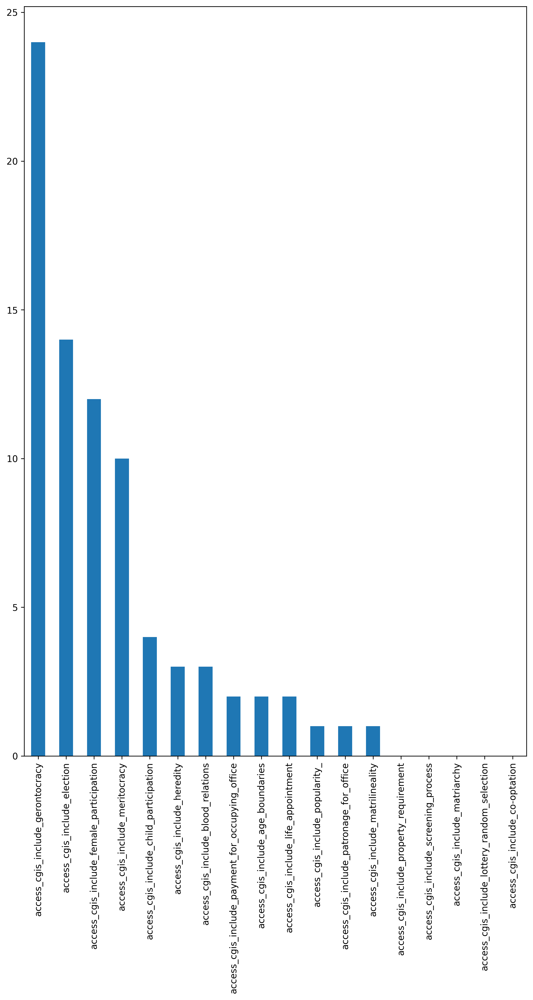

In [22]:
cgi_df[access_cgis].sum().sort_values(ascending=False).plot(kind='bar', figsize=(10,15))

In [23]:
decision_making_cgis = [x for x in cgi_df.columns if 'decision_making_cgis_' in x]

<Axes: >

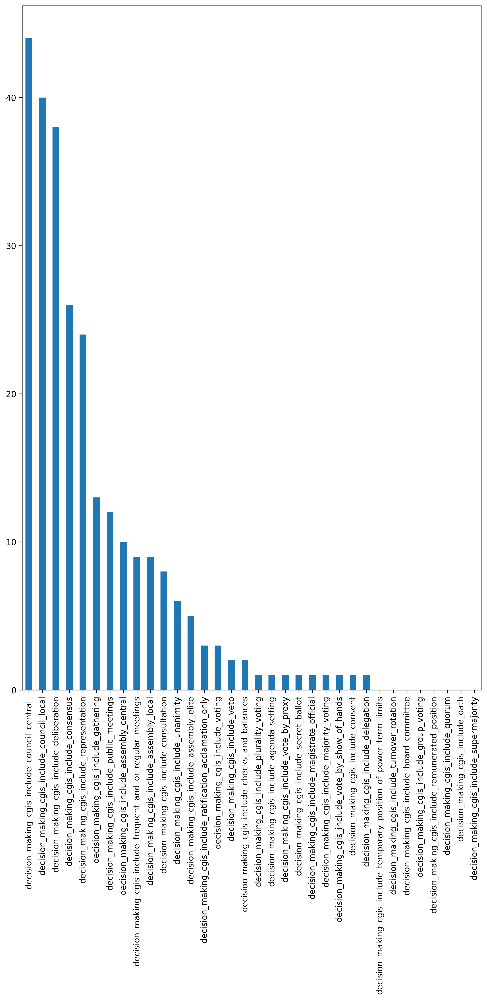

In [24]:
cgi_df[decision_making_cgis].sum().sort_values(ascending=False).plot(kind='bar', figsize=(10,15))

In [25]:
enforcement_cgis = [x for x in cgi_df.columns if 'enforcement_cgis_' in x]

<Axes: >

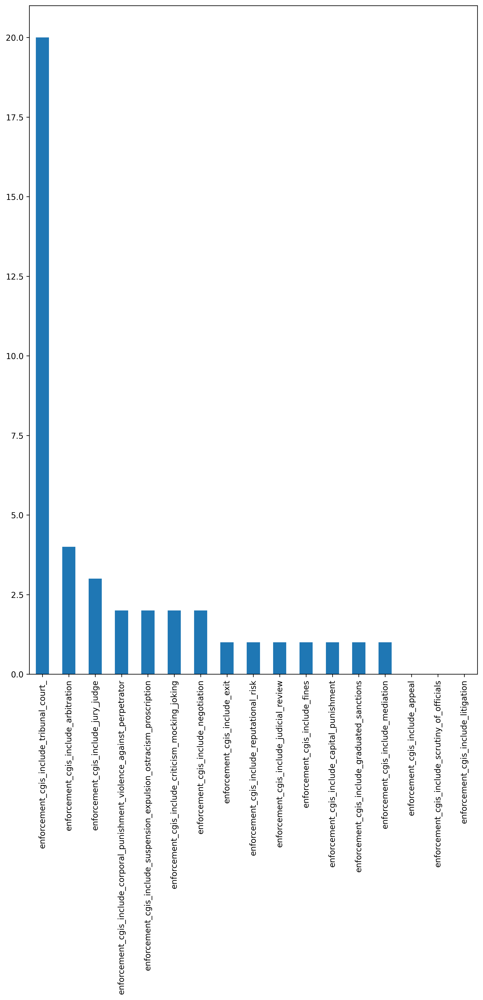

In [26]:
cgi_mechanisms_df[enforcement_cgis].sum().sort_values(ascending=False).plot(kind='bar', figsize=(10,15))

# CGI Mechanism Analysis 

In [27]:
# Select columns of interest

In [28]:
list(cgi_df)

['Institution_Name',
 'Community_Name',
 'Mechanism',
 'Notes',
 'Time span',
 'Geography',
 'Size',
 'Source',
 'Heterogeneity ',
 'Time span: Start',
 'Time span: End',
 'SCCS',
 'is_SCCS',
 'decision_making_mechanisms_include_frequent_and_or_regular_meetings',
 'enforcement_mechanisms_include_capital_punishment',
 'decision_making_mechanisms_include_deliberation',
 'decision_making_mechanisms_include_power_fluidity',
 'decision_making_mechanisms_include_council_central_',
 'enforcement_mechanisms_include_seizing_of_property',
 'decision_making_mechanisms_include_board_committee',
 'enforcement_mechanisms_include_monitoring',
 'decision_making_mechanisms_include_bureaucracy',
 'enforcement_mechanisms_include_fines',
 'decision_making_mechanisms_include_plurality_voting',
 'enforcement_mechanisms_include_criticism_mocking_joking',
 'access_mechanisms_include_age_boundaries',
 'access_mechanisms_include_popularity_',
 'access_mechanisms_include_co-optation',
 'decision_making_mechanism

In [29]:
# Drop community mechanisms
mechanisms_list = [x for x in cgi_df.columns if x.startswith('mechanisms')]
mechanisms_list

[]

In [30]:
cgi_df.drop(columns=mechanisms_list, inplace=True)

In [31]:
list(cgi_df)

['Institution_Name',
 'Community_Name',
 'Mechanism',
 'Notes',
 'Time span',
 'Geography',
 'Size',
 'Source',
 'Heterogeneity ',
 'Time span: Start',
 'Time span: End',
 'SCCS',
 'is_SCCS',
 'decision_making_mechanisms_include_frequent_and_or_regular_meetings',
 'enforcement_mechanisms_include_capital_punishment',
 'decision_making_mechanisms_include_deliberation',
 'decision_making_mechanisms_include_power_fluidity',
 'decision_making_mechanisms_include_council_central_',
 'enforcement_mechanisms_include_seizing_of_property',
 'decision_making_mechanisms_include_board_committee',
 'enforcement_mechanisms_include_monitoring',
 'decision_making_mechanisms_include_bureaucracy',
 'enforcement_mechanisms_include_fines',
 'decision_making_mechanisms_include_plurality_voting',
 'enforcement_mechanisms_include_criticism_mocking_joking',
 'access_mechanisms_include_age_boundaries',
 'access_mechanisms_include_popularity_',
 'access_mechanisms_include_co-optation',
 'decision_making_mechanism

## Normalized Correlation Matrix

In [32]:
data_plot = cgi_df.select_dtypes(include=[np.number])

In [33]:
data_plot.describe()

,Time span: Start,Time span: End,is_SCCS,decision_making_mechanisms_include_frequent_and_or_regular_meetings,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_council_central_,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_board_committee,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_bureaucracy,enforcement_mechanisms_include_fines,decision_making_mechanisms_include_plurality_voting,enforcement_mechanisms_include_criticism_mocking_joking,access_mechanisms_include_age_boundaries,access_mechanisms_include_popularity_,access_mechanisms_include_co-optation,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_autocratic_leader_chief_bound,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_destruction_of_property,access_mechanisms_include_heredity,access_mechanisms_include_matriarchy,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_forced_labour,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_petition,access_mechanisms_include_life_appointment,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_balance_of_power,enforcement_mechanisms_include_arbitration,access_mechanisms_include_screening_process,enforcement_mechanisms_include_self-help,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_delegation,access_mechanisms_include_dreaming,access_mechanisms_include_blood_relations,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_vote_by_show_of_hands,access_mechanisms_include_divine_right,decision_making_mechanisms_include_leader_first_among_equals,enforcement_mechanisms_include_scrutiny_of_officials,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_political_unit,access_mechanisms_include_meritocracy,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_remunerated_position,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_turnover_rotation,enforcement_mechanisms_include_paying_damages_compensation,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_voting,access_mechanisms_include_induction_rite_ceremony,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_council_local,access_mechanisms_include_enfranchisement,decision_making_mechanisms_

In [ ]:
data_plot

In [35]:
normalized = Normalizer().fit_transform(data_plot)

norm_df = pd.DataFrame(normalized)
norm_df.columns = data_plot.columns
norm_corr = norm_df.corr()

norm_corr

,Time span: Start,Time span: End,is_SCCS,decision_making_mechanisms_include_frequent_and_or_regular_meetings,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_council_central_,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_board_committee,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_bureaucracy,enforcement_mechanisms_include_fines,decision_making_mechanisms_include_plurality_voting,enforcement_mechanisms_include_criticism_mocking_joking,access_mechanisms_include_age_boundaries,access_mechanisms_include_popularity_,access_mechanisms_include_co-optation,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_autocratic_leader_chief_bound,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_destruction_of_property,access_mechanisms_include_heredity,access_mechanisms_include_matriarchy,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_forced_labour,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_petition,access_mechanisms_include_life_appointment,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_balance_of_power,enforcement_mechanisms_include_arbitration,access_mechanisms_include_screening_process,enforcement_mechanisms_include_self-help,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_delegation,access_mechanisms_include_dreaming,access_mechanisms_include_blood_relations,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_vote_by_show_of_hands,access_mechanisms_include_divine_right,decision_making_mechanisms_include_leader_first_among_equals,enforcement_mechanisms_include_scrutiny_of_officials,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_political_unit,access_mechanisms_include_meritocracy,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_remunerated_position,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_turnover_rotation,enforcement_mechanisms_include_paying_damages_compensation,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_voting,access_mechanisms_include_induction_rite_ceremony,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_council_local,access_mechanisms_include_enfranchisement,decision_making_mechanisms_

In [36]:
norm_corr.head()

,Time span: Start,Time span: End,is_SCCS,decision_making_mechanisms_include_frequent_and_or_regular_meetings,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_council_central_,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_board_committee,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_bureaucracy,enforcement_mechanisms_include_fines,decision_making_mechanisms_include_plurality_voting,enforcement_mechanisms_include_criticism_mocking_joking,access_mechanisms_include_age_boundaries,access_mechanisms_include_popularity_,access_mechanisms_include_co-optation,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_autocratic_leader_chief_bound,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_destruction_of_property,access_mechanisms_include_heredity,access_mechanisms_include_matriarchy,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_forced_labour,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_petition,access_mechanisms_include_life_appointment,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_balance_of_power,enforcement_mechanisms_include_arbitration,access_mechanisms_include_screening_process,enforcement_mechanisms_include_self-help,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_delegation,access_mechanisms_include_dreaming,access_mechanisms_include_blood_relations,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_vote_by_show_of_hands,access_mechanisms_include_divine_right,decision_making_mechanisms_include_leader_first_among_equals,enforcement_mechanisms_include_scrutiny_of_officials,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_political_unit,access_mechanisms_include_meritocracy,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_remunerated_position,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_turnover_rotation,enforcement_mechanisms_include_paying_damages_compensation,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_voting,access_mechanisms_include_induction_rite_ceremony,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_council_local,access_mechanisms_include_enfranchisement,decision_making_mechanisms_

# Visualize and Sort CGI Correlations

/var/folders/v7/8x_7ty4j3m76hgg7tncks_kc0000gn/T/ipykernel_67979/3758718678.py:4: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask = np.triu(np.ones_like(norm_corr, dtype=np.bool))


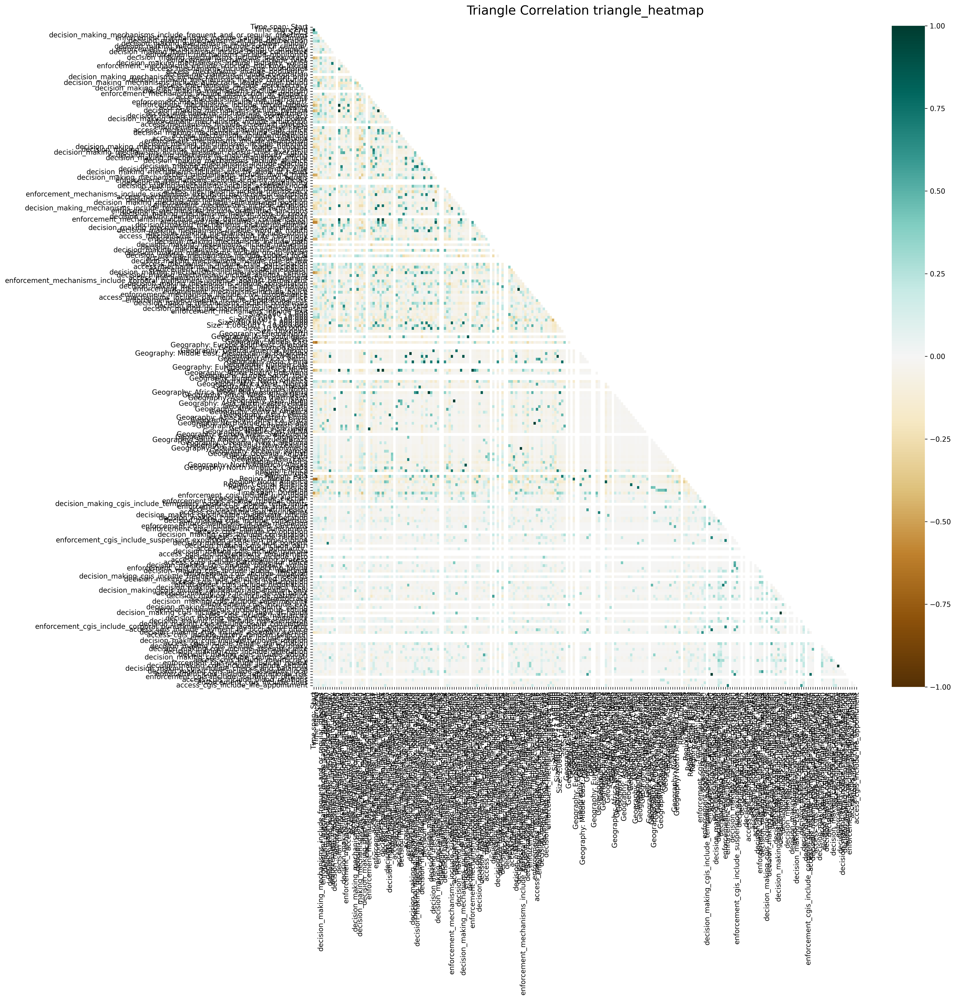

In [37]:
plt.figure(figsize=(20,20))

# define the mask to set the values in the upper triangle to True
mask = np.triu(np.ones_like(norm_corr, dtype=np.bool))

triangle_heatmap = sns.heatmap(
    norm_corr, 
    mask=mask, 
    vmin=-1, 
    vmax=1, 
    annot=False, 
    cmap='BrBG', 
    xticklabels=1, 
    yticklabels=1)

triangle_heatmap.set_title('Triangle Correlation triangle_heatmap', fontdict={'fontsize':18}, pad=16);

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_triangle_correlations.png')
plt.show()

In [38]:
cgis_list = [x for x in cgi_df.columns if 'cgis_' in x]
cgis_list

['enforcement_cgis_include_jury_judge',
 'access_cgis_include_election',
 'enforcement_cgis_include_tribunal_court_',
 'decision_making_cgis_include_temporary_position_of_power_term_limits',
 'enforcement_cgis_include_arbitration',
 'access_cgis_include_matrilineality',
 'access_cgis_include_age_boundaries',
 'decision_making_cgis_include_magistrate_official',
 'decision_making_cgis_include_deliberation',
 'decision_making_cgis_include_consensus',
 'enforcement_cgis_include_mediation',
 'enforcement_cgis_include_graduated_sanctions',
 'enforcement_cgis_include_capital_punishment',
 'access_cgis_include_co-optation',
 'decision_making_cgis_include_consultation',
 'access_cgis_include_heredity',
 'enforcement_cgis_include_suspension_expulsion_ostracism_proscription',
 'decision_making_cgis_include_consent',
 'decision_making_cgis_include_oath',
 'access_cgis_include_popularity_',
 'decision_making_cgis_include_quorum',
 'access_cgis_include_property_requirement',
 'decision_making_cgis_i

In [39]:
cgis_df = norm_corr[cgis_list]

In [40]:
cgis_df

,enforcement_cgis_include_jury_judge,access_cgis_include_election,enforcement_cgis_include_tribunal_court_,decision_making_cgis_include_temporary_position_of_power_term_limits,enforcement_cgis_include_arbitration,access_cgis_include_matrilineality,access_cgis_include_age_boundaries,decision_making_cgis_include_magistrate_official,decision_making_cgis_include_deliberation,decision_making_cgis_include_consensus,enforcement_cgis_include_mediation,enforcement_cgis_include_graduated_sanctions,enforcement_cgis_include_capital_punishment,access_cgis_include_co-optation,decision_making_cgis_include_consultation,access_cgis_include_heredity,enforcement_cgis_include_suspension_expulsion_ostracism_proscription,decision_making_cgis_include_consent,decision_making_cgis_include_oath,access_cgis_include_popularity_,decision_making_cgis_include_quorum,access_cgis_include_property_requirement,decision_making_cgis_include_veto,access_cgis_include_screening_process,access_cgis_include_patronage_for_office,decision_making_cgis_include_plurality_voting,enforcement_cgis_include_criticism_mocking_joking,decision_making_cgis_include_public_meetings,enforcement_cgis_include_litigation,decision_making_cgis_include_frequent_and_or_regular_meetings,decision_making_cgis_include_remunerated_position,access_cgis_include_child_participation,enforcement_cgis_include_negotiation,decision_making_cgis_include_council_local,decision_making_cgis_include_ratification_acclamation_only,decision_making_cgis_include_secret_ballot,decision_making_cgis_include_gathering,access_cgis_include_gerontocracy,decision_making_cgis_include_supermajority,enforcement_cgis_include_exit,decision_making_cgis_include_majority_voting,decision_making_cgis_include_group_voting,decision_making_cgis_include_vote_by_show_of_hands,access_cgis_include_matriarchy,decision_making_cgis_include_unanimity,decision_making_cgis_include_representation,decision_making_cgis_include_board_committee,enforcement_cgis_include_corporal_punishment_violence_against_perpetrator,access_cgis_include_payment_for_occupying_office,decision_making_cgis_include_assembly_central,access_cgis_include_lottery_random_selection,enforcement_cgis_include_appeal,decision_making_cgis_include_turnover_rotation,access_cgis_include_female_participation,decision_making_cgis_include_vote_by_proxy,decision_making_cgis_include_assembly_elite,decision_making_cgis_include_delegation,decision_making_cgis_include_voting,decision_making_cgis_include_council_central_,access_cgis_include_meritocracy,enforcement_cgis_include_judicial_review,decision_making_cgis_include_agenda_setting,decision_making_cgis_include_checks_and_balances,decision_making_cgis_include_assembly_local,enforcement_cgis_include_reputational_risk,enforcement_cgis_include_scrutiny_of_officials,access_cgis_include_blood_relations,enforcement_cgis_include_fines,access_cgis_include_life_appointment
Time span: Start,-0.195137,-0.037811,-0.034050,NaN,0.047322,0.010207,0.035699,0.023078,0.112515,0.123727,0.027232,0.029673,0.027905,NaN,-0.077216,0.036876,0.042023,0.029776,NaN,0.027491,NaN,NaN,0.040042,NaN,0.027232,0.029284,0.042023,0.001777,NaN,0.035292,NaN,0.058477,0.038728,0.103574,-0.025297,0.029776,0.051914,0.132951,NaN,0.020075,0.029673,NaN,0.029776,NaN,0.025245,0.088078,NaN,0.034344,0.010907,-0.207066,NaN,NaN,NaN,0.080853,0.029352,-0.058834,0.020075,0.037285,-0.043581,0.078055,0.011007,0.011007,0.018697,-0.057992,0.010207,NaN,0.036692,0.029673,0.039960
Time span: End,-0.181364,-0.006666,-0.031243,NaN,0.051458,0.030906,0.034827,0.026461,0.123822,0.131607,0.023657,0.021532,0.023111,NaN,-0.033672,0.044648,0.030493,0.021433,NaN,0.023450,NaN,NaN,0.032161,NaN,0.023657,0.021899,0.030493,0.009344,NaN,0.044780,NaN,0.044222,0.033347,0.110265,-0.032985,0.021433,0.078890,0.119337,NaN,0.027991,0.021532,NaN,0.021433,NaN,0.018455,0.111307,NaN,0.035476,0.043824,-0.160211,NaN,NaN,NaN,0.086239,0.021836,-0.021777,0.027991,0.045623,-0.010537,0.077898,0.030770,0.030770,0.042068,-0.047582,0.0309

In [41]:
query_cgis_df = cgis_df.transpose()

In [42]:
query_cgis_df.head()

,Time span: Start,Time span: End,is_SCCS,decision_making_mechanisms_include_frequent_and_or_regular_meetings,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_council_central_,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_board_committee,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_bureaucracy,enforcement_mechanisms_include_fines,decision_making_mechanisms_include_plurality_voting,enforcement_mechanisms_include_criticism_mocking_joking,access_mechanisms_include_age_boundaries,access_mechanisms_include_popularity_,access_mechanisms_include_co-optation,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_autocratic_leader_chief_bound,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_destruction_of_property,access_mechanisms_include_heredity,access_mechanisms_include_matriarchy,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_forced_labour,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_petition,access_mechanisms_include_life_appointment,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_balance_of_power,enforcement_mechanisms_include_arbitration,access_mechanisms_include_screening_process,enforcement_mechanisms_include_self-help,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_delegation,access_mechanisms_include_dreaming,access_mechanisms_include_blood_relations,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_vote_by_show_of_hands,access_mechanisms_include_divine_right,decision_making_mechanisms_include_leader_first_among_equals,enforcement_mechanisms_include_scrutiny_of_officials,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_political_unit,access_mechanisms_include_meritocracy,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_remunerated_position,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_turnover_rotation,enforcement_mechanisms_include_paying_damages_compensation,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_voting,access_mechanisms_include_induction_rite_ceremony,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_council_local,access_mechanisms_include_enfranchisement,decision_making_mechanisms_

## Time x Region x Size for CGIs

In [43]:
time_span_cols = ['Time span: Start', 'Time span: End', 'Time span: Duration']

In [44]:
region_cols = [r for r in list(cgi_df) if 'Region: ' in r] 

In [45]:
size_cols = [
    'Size: 100 - 1,000',
    'Size: 1,001 - 10,000',
    'Size: 10,001 - 100,000',
    'Size: 100,001 - 1,000,000',
    'Size: 1,000,001 - 10,000,000',
    'Size: 10,000,000+',
    'Size: Unknown'
]

In [46]:
list(cgi_df.columns)

['Institution_Name',
 'Community_Name',
 'Mechanism',
 'Notes',
 'Time span',
 'Geography',
 'Size',
 'Source',
 'Heterogeneity ',
 'Time span: Start',
 'Time span: End',
 'SCCS',
 'is_SCCS',
 'decision_making_mechanisms_include_frequent_and_or_regular_meetings',
 'enforcement_mechanisms_include_capital_punishment',
 'decision_making_mechanisms_include_deliberation',
 'decision_making_mechanisms_include_power_fluidity',
 'decision_making_mechanisms_include_council_central_',
 'enforcement_mechanisms_include_seizing_of_property',
 'decision_making_mechanisms_include_board_committee',
 'enforcement_mechanisms_include_monitoring',
 'decision_making_mechanisms_include_bureaucracy',
 'enforcement_mechanisms_include_fines',
 'decision_making_mechanisms_include_plurality_voting',
 'enforcement_mechanisms_include_criticism_mocking_joking',
 'access_mechanisms_include_age_boundaries',
 'access_mechanisms_include_popularity_',
 'access_mechanisms_include_co-optation',
 'decision_making_mechanism

## Time x CGIs

In [47]:
time_cgis = query_cgis_df[time_span_cols]
time_cgis

,Time span: Start,Time span: End,Time span: Duration
enforcement_cgis_include_jury_judge,-0.195137,-0.181364,0.117981
access_cgis_include_election,-0.037811,-0.006666,0.109846
enforcement_cgis_include_tribunal_court_,-0.034050,-0.031243,0.021819
decision_making_cgis_include_temporary_position_of_power_term_limits,NaN,NaN,NaN
enforcement_cgis_include_arbitration,0.047322,0.051458,-0.005777
access_cgis_include_matrilineality,0.010207,0.030906,0.059258
access_cgis_include_age_boundaries,0.035699,0.034827,-0.016550
decision_making_cgis_include_magistrate_official,0.023078,0.026461,0.001356
decision_making_cgis_include_deliberation,0.112515,0.123822,-0.009232
decision_making_cgis_include_consensus,0.123727,0.131607,-0.024060


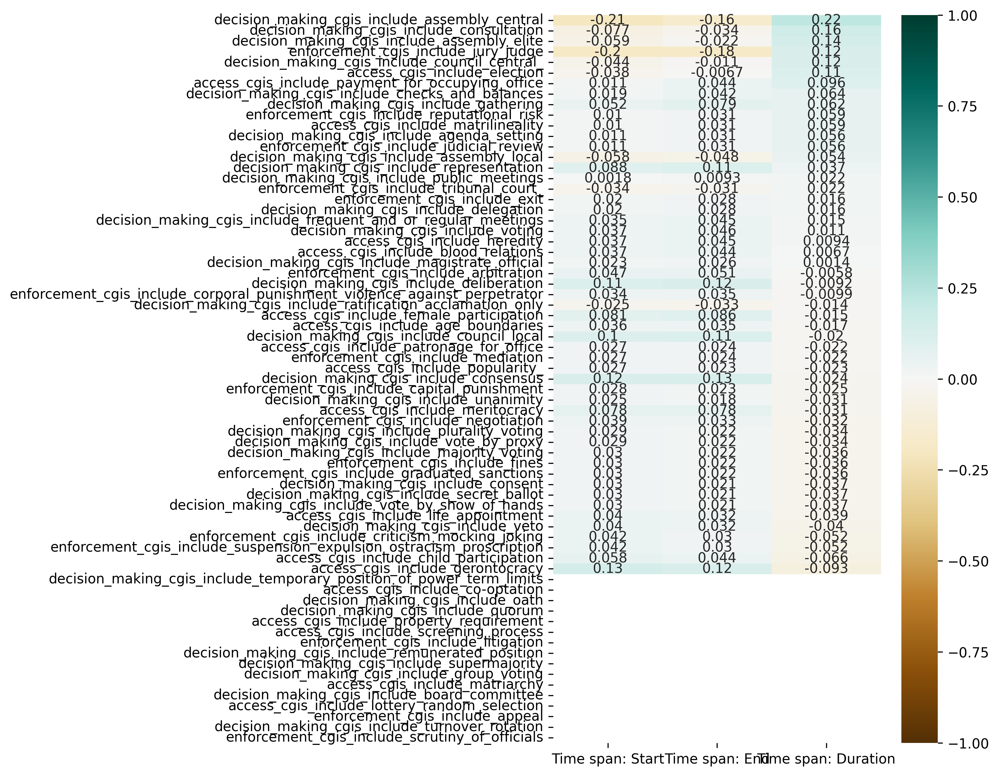

In [48]:
plt.figure(figsize=(10,8))

sns.heatmap(time_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_time.png')
plt.show()

### Time x CGIs: Access, Decision Making, Enforcement

In [49]:
access_cgis

['access_cgis_include_election',
 'access_cgis_include_matrilineality',
 'access_cgis_include_age_boundaries',
 'access_cgis_include_co-optation',
 'access_cgis_include_heredity',
 'access_cgis_include_popularity_',
 'access_cgis_include_property_requirement',
 'access_cgis_include_screening_process',
 'access_cgis_include_patronage_for_office',
 'access_cgis_include_child_participation',
 'access_cgis_include_gerontocracy',
 'access_cgis_include_matriarchy',
 'access_cgis_include_payment_for_occupying_office',
 'access_cgis_include_lottery_random_selection',
 'access_cgis_include_female_participation',
 'access_cgis_include_meritocracy',
 'access_cgis_include_blood_relations',
 'access_cgis_include_life_appointment']

In [50]:
time_access_cgis = time_cgis.loc[access_cgis]

In [51]:
time_access_cgis

,Time span: Start,Time span: End,Time span: Duration
access_cgis_include_election,-0.037811,-0.006666,0.109846
access_cgis_include_matrilineality,0.010207,0.030906,0.059258
access_cgis_include_age_boundaries,0.035699,0.034827,-0.016550
access_cgis_include_co-optation,NaN,NaN,NaN
access_cgis_include_heredity,0.036876,0.044648,0.009396
access_cgis_include_popularity_,0.027491,0.023450,-0.023036
access_cgis_include_property_requirement,NaN,NaN,NaN
access_cgis_include_screening_process,NaN,NaN,NaN
access_cgis_include_patronage_for_office,0.027232,0.023657,-0.021514
access_cgis_include_child_participation,0.058477,0.044222,-0.066291


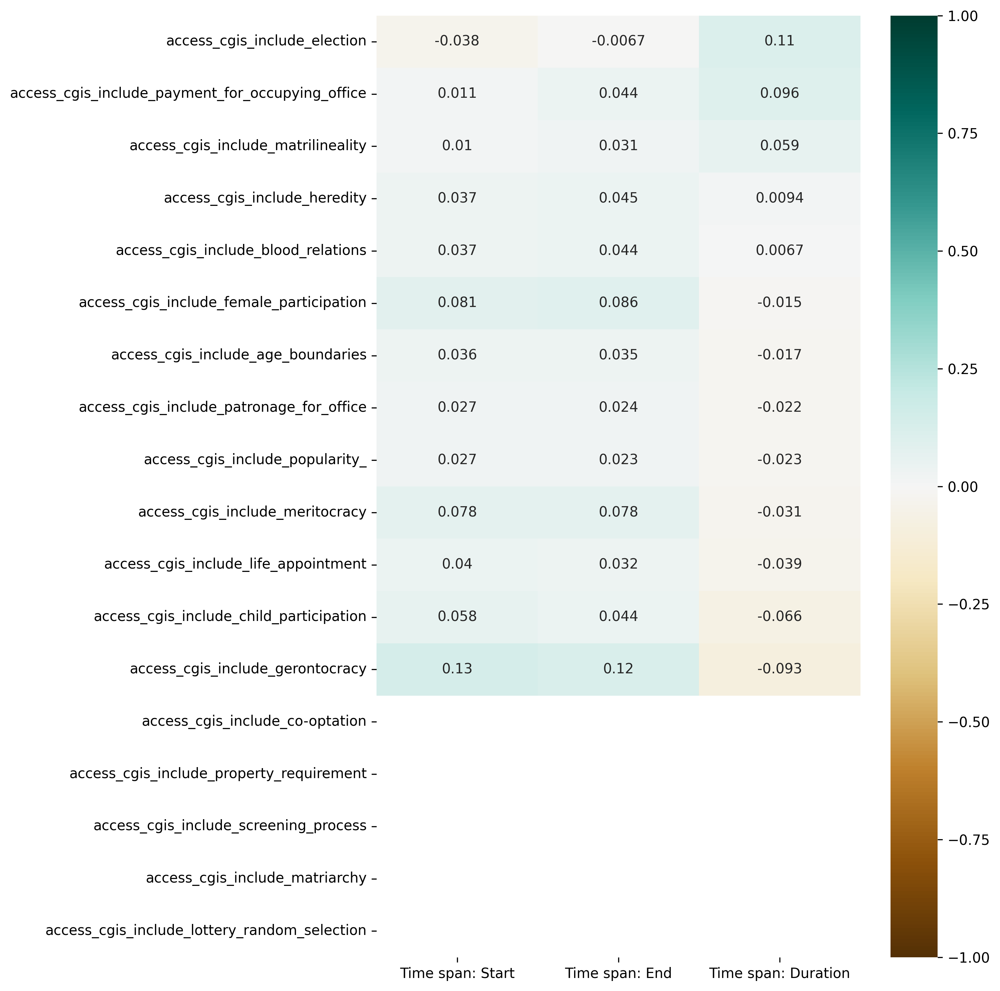

In [52]:
plt.figure(figsize=(10,10))

sns.heatmap(time_access_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'time_access_cgis.png')
plt.show()

In [53]:
time_decision_making_cgis = time_cgis.loc[decision_making_cgis]

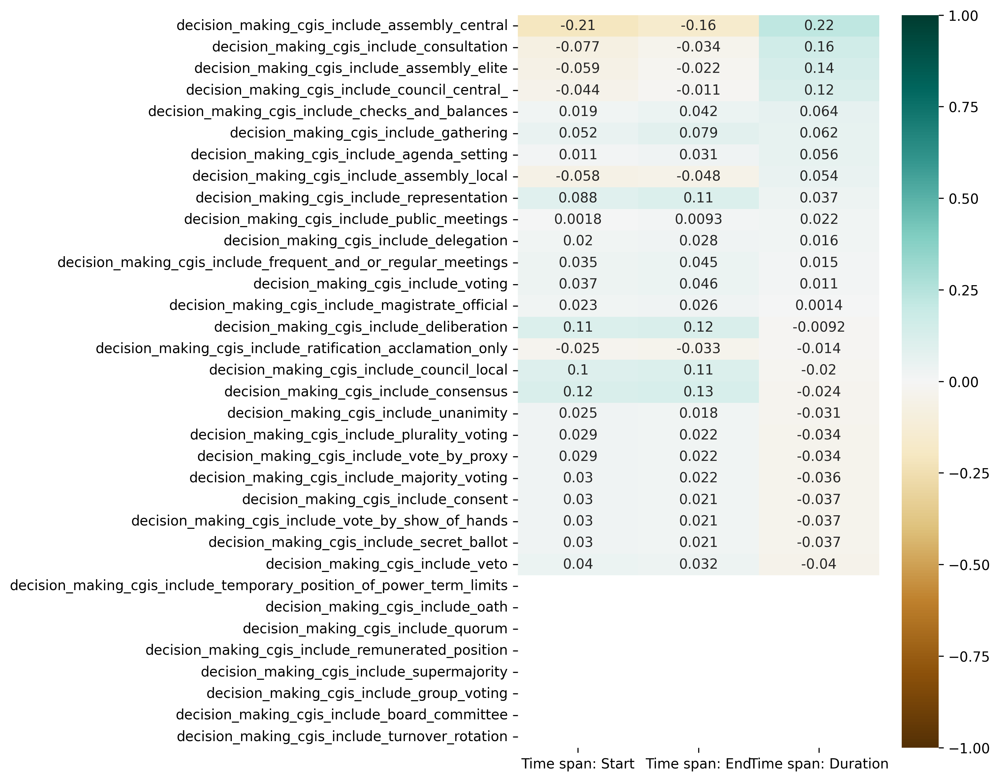

In [54]:
plt.figure(figsize=(10,8))

sns.heatmap(time_decision_making_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'time_decision_making_cgis.png')
plt.show()

In [55]:
time_enforcement_cgis = time_cgis.loc[enforcement_cgis]

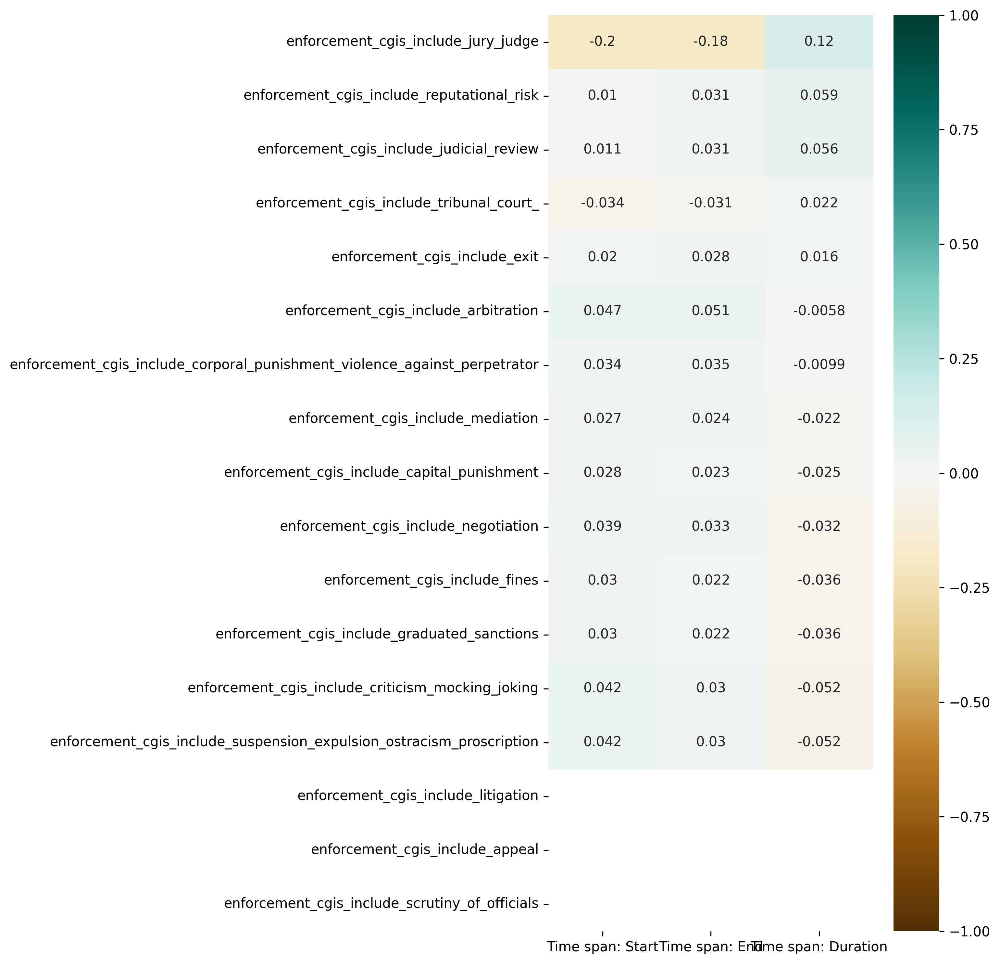

In [56]:
plt.figure(figsize=(10,10))

sns.heatmap(time_enforcement_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'time_enforcement_cgis.png')
plt.show()

## Region x CGIs

In [57]:
region_cgis = query_cgis_df[region_cols]
region_cgis

,Region: Africa,Region: Europe,Region: Asia,Region: Middle East,Region: North America,Region: Central America,Region: South America,Region: Oceania
enforcement_cgis_include_jury_judge,0.020947,NaN,-0.047626,0.062705,-0.055747,-0.019915,-0.014457,-0.023687
access_cgis_include_election,0.268367,NaN,0.021652,-0.052404,-0.025791,0.028631,-0.025425,-0.041656
enforcement_cgis_include_tribunal_court_,-0.034032,NaN,0.023697,0.014192,-0.070540,0.029131,-0.038334,0.045981
decision_making_cgis_include_temporary_position_of_power_term_limits,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
enforcement_cgis_include_arbitration,-0.043776,NaN,0.038742,-0.034755,-0.065020,-0.023228,-0.016862,0.207869
access_cgis_include_matrilineality,0.080905,NaN,-0.027706,-0.017335,-0.032430,-0.011585,-0.008411,-0.013780
access_cgis_include_age_boundaries,0.017158,NaN,-0.039234,-0.024547,-0.045923,-0.016405,0.211617,-0.019513
decision_making_cgis_include_magistrate_official,0.059313,NaN,-0.027706,-0.017335,-0.032430,-0.011585,-0.008411,-0.013780
decision_making_cgis_include_deliberation,-0.045832,NaN,-0.097814,-0.077068,0.121221,0.052705,-0.054442,0.094771
decision_making_cgis_include_consensus,-0.076685,NaN,-0.017174,-0.091168,0.084688,0.051101,0.013519,0.099017


In [58]:
# Move Region: Europe to first col 
cols_to_move = ['Region: Europe']
region_cgis = region_cgis[cols_to_move + [col for col in region_cgis.columns if col not in cols_to_move ]]

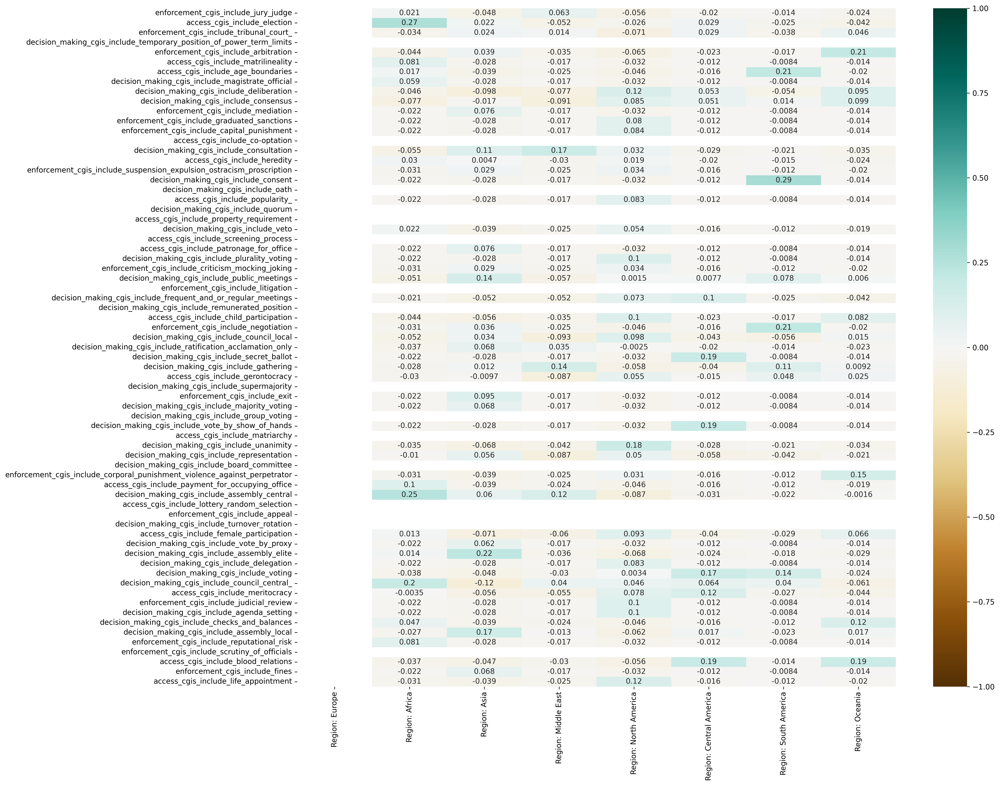

In [59]:
plt.figure(figsize=(20,15))

sns.heatmap(region_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_region.png')
plt.show()

### Region x CGIs: Access, Decision Making, Enforcement

In [60]:
region_access_cgis = region_cgis.loc[access_cgis]

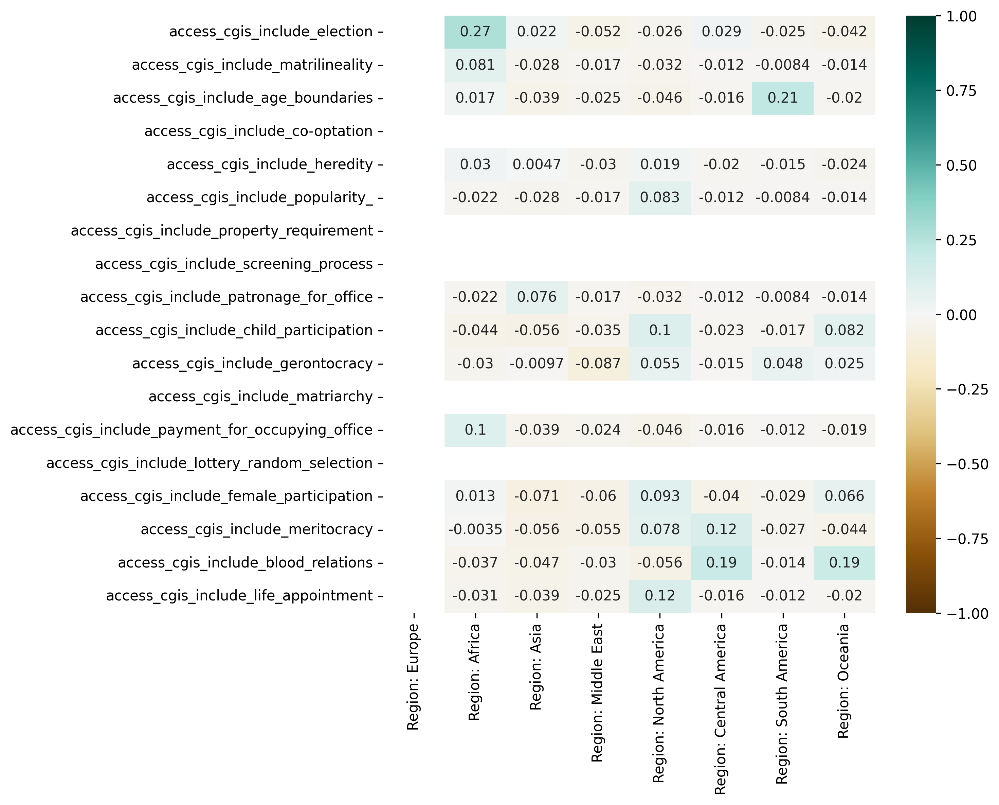

In [61]:
plt.figure(figsize=(10,8))

sns.heatmap(region_access_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'region_access_cgis.png')
plt.show()

In [62]:
region_decision_making_cgis = region_cgis.loc[decision_making_cgis]

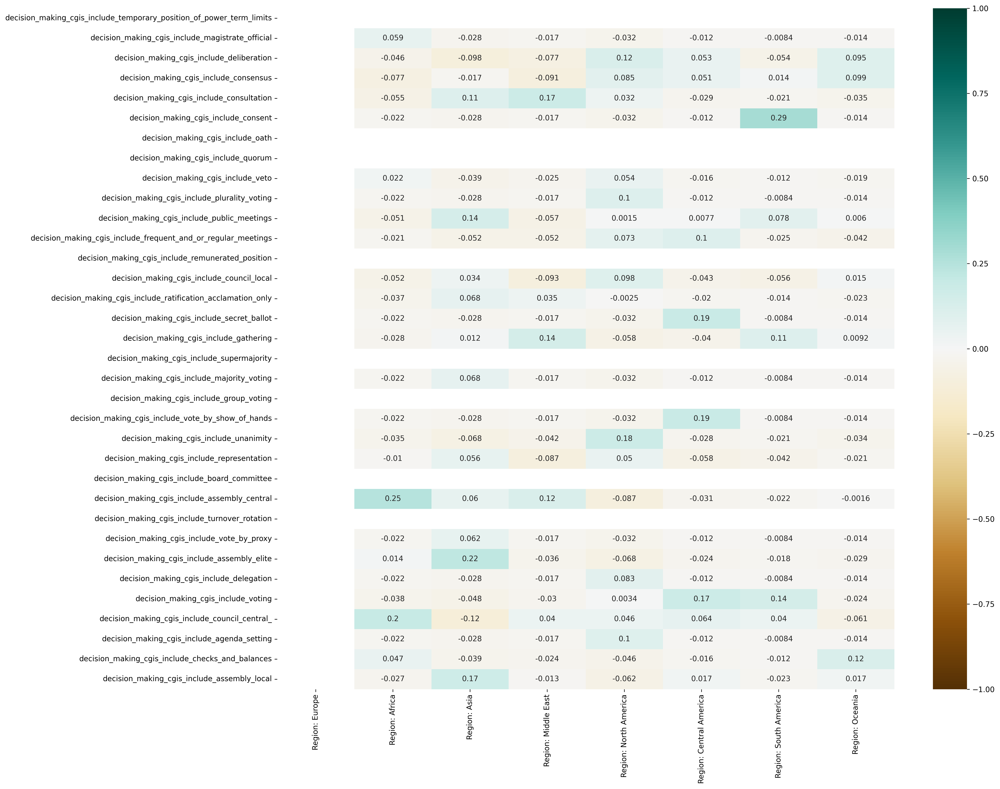

In [63]:
plt.figure(figsize=(20,15))

sns.heatmap(region_decision_making_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'region_decision_making_cgis.png')
plt.show()

In [64]:
region_enforcement_cgis = region_cgis.loc[enforcement_cgis]

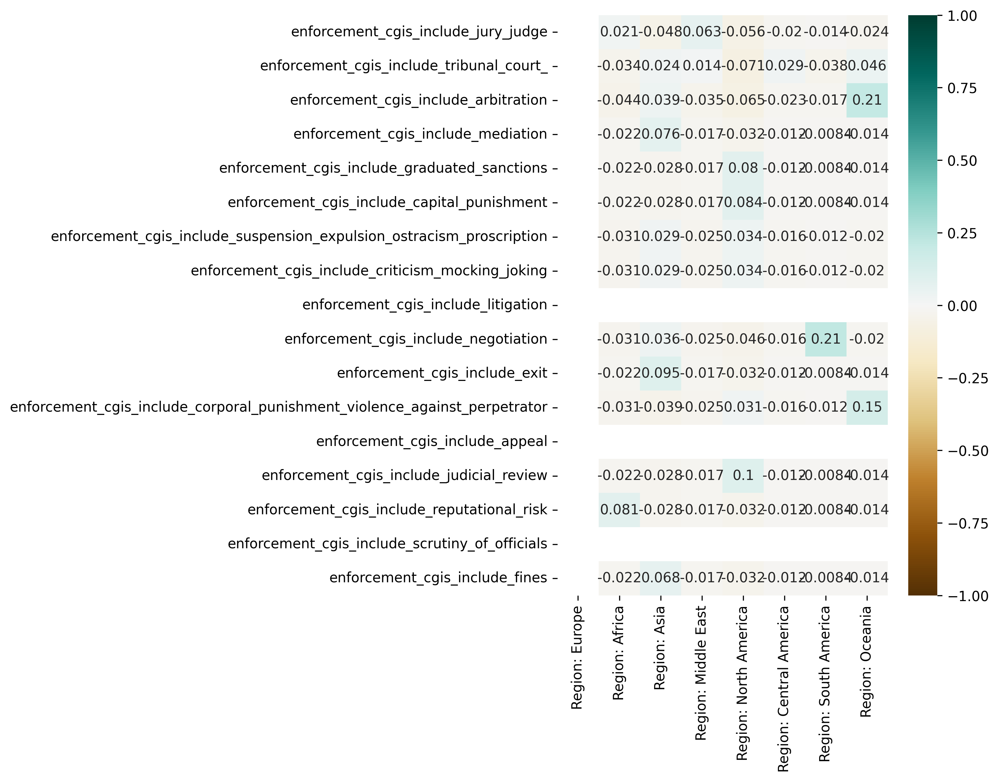

In [65]:
plt.figure(figsize=(10,8))

sns.heatmap(region_enforcement_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'region_enforcement_cgis.png')
plt.show()

## Size x CGIs

In [66]:
size_cgis = query_cgis_df[size_cols]

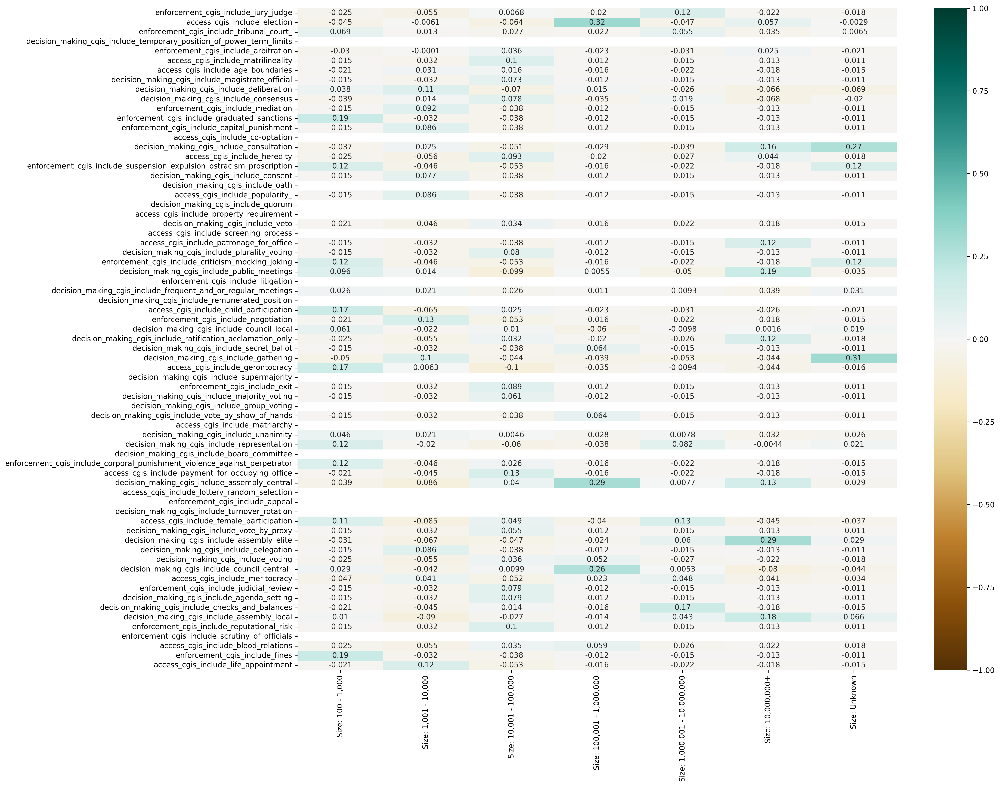

In [67]:
plt.figure(figsize=(20,15))

sns.heatmap(size_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_size.png')
plt.show()

### Size x CGIs: Access, Decision Making, Enforcement

In [68]:
size_access_cgis = size_cgis.loc[access_cgis]

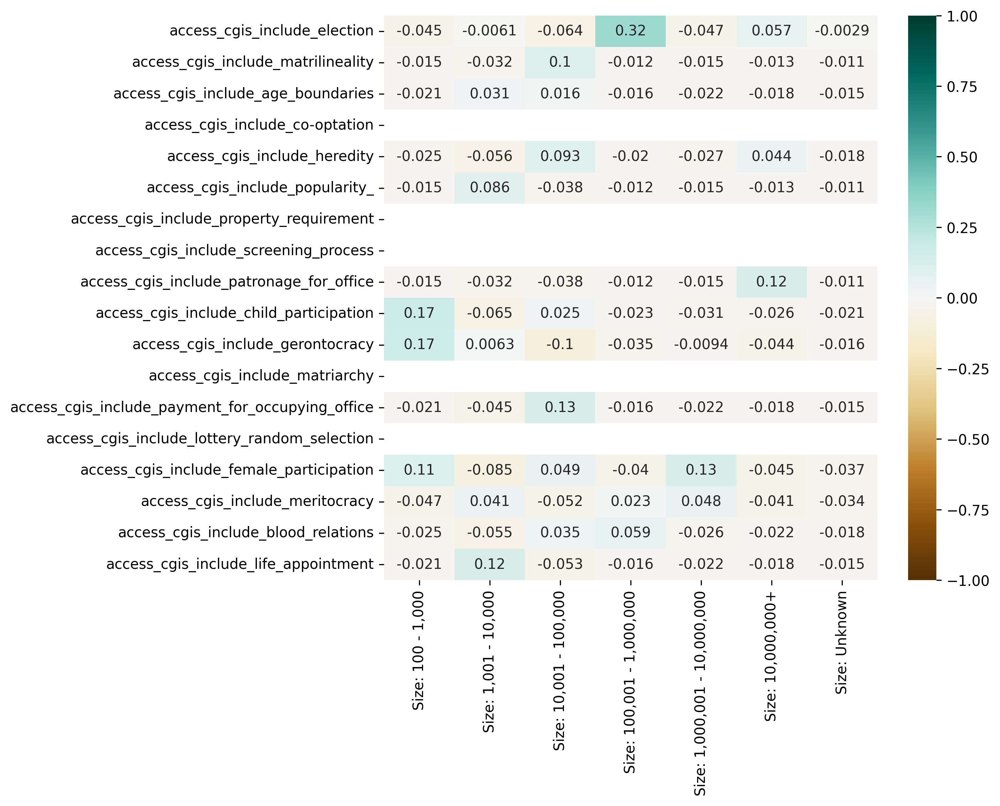

In [69]:
plt.figure(figsize=(10,8))

sns.heatmap(size_access_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'size_access_cgis.png')
plt.show()

In [70]:
size_decision_making_cgis = size_cgis.loc[decision_making_cgis]

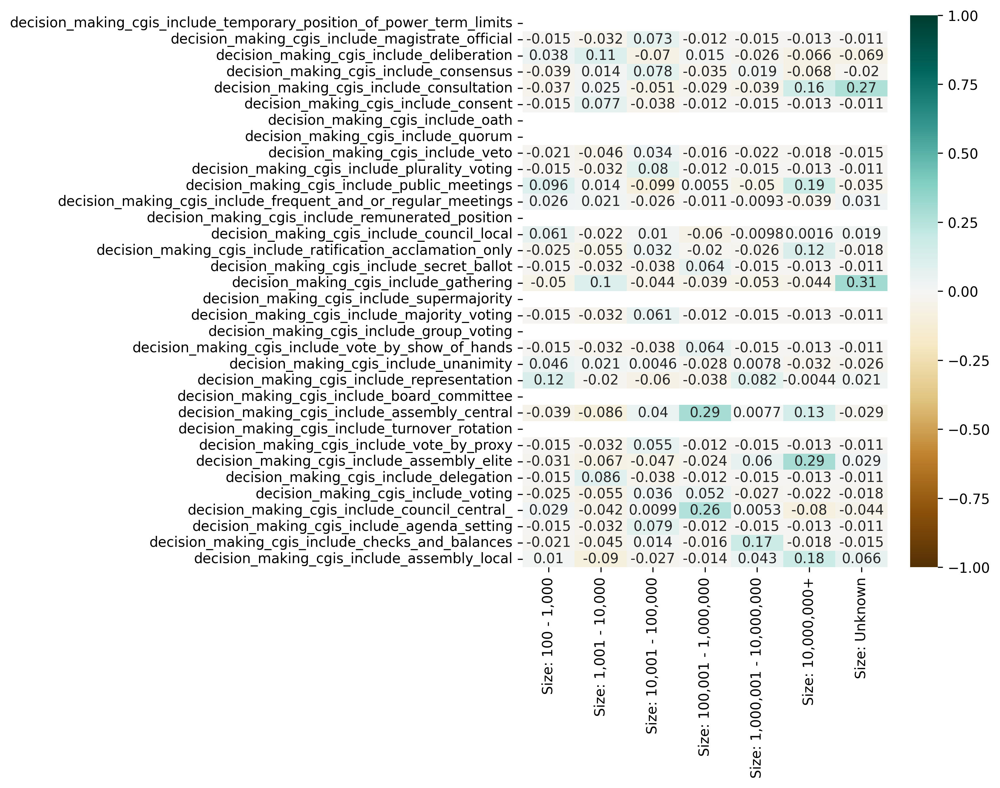

In [71]:
plt.figure(figsize=(10,8))

sns.heatmap(size_decision_making_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'size_decision_making_cgis.png')
plt.show()

In [72]:
size_enforcement_cgis = size_cgis.loc[enforcement_cgis]

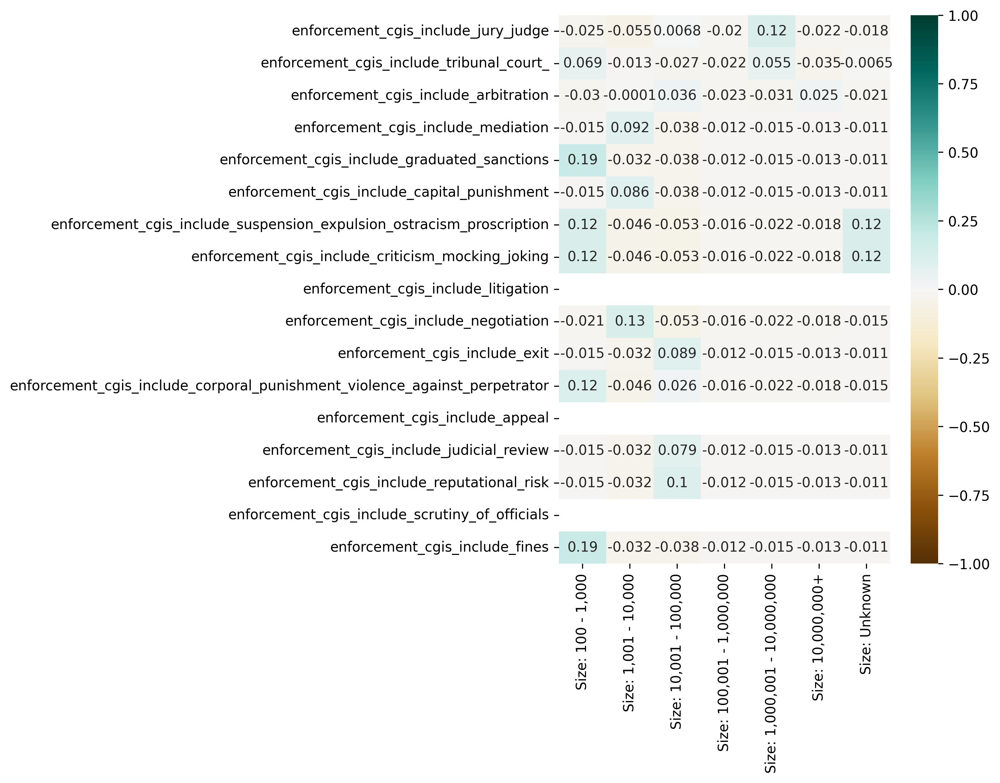

In [73]:
plt.figure(figsize=(10,8))

sns.heatmap(size_enforcement_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'size_enforcement_cgis.png')
plt.show()

# Sorted positive and negative correlations

In [74]:
def get_redundant_pairs(df):
    '''Get diagonal and lower triangular pairs of correlation matrix'''
    pairs_to_drop = set()
    cols = df.columns
    for i in range(0, df.shape[1]):
        for j in range(0, i+1):
            pairs_to_drop.add((cols[i], cols[j]))
    return pairs_to_drop

In [75]:
def get_sorted_correlations(corr_df, n=100, ascending=False):
    au_corr = corr_df.unstack()
    labels_to_drop = get_redundant_pairs(corr_df)
    au_corr = au_corr.drop(labels=labels_to_drop).sort_values(ascending=ascending)
    return au_corr

In [76]:
# Highest 200 positively correlated variables
print(get_sorted_correlations(norm_corr, n=200, ascending=False))

decision_making_cgis_include_secret_ballot      decision_making_cgis_include_vote_by_show_of_hands    1.0
enforcement_mechanisms_include_forced_labour    Geography: Africa North                               1.0
access_cgis_include_matrilineality              enforcement_cgis_include_reputational_risk            1.0
decision_making_mechanisms_include_bureaucracy  enforcement_mechanisms_include_forced_labour          1.0
                                                decision_making_mechanisms_include_petition           1.0
                                                                                                     ... 
decision_making_cgis_include_assembly_local     enforcement_cgis_include_scrutiny_of_officials        NaN
enforcement_cgis_include_reputational_risk      enforcement_cgis_include_scrutiny_of_officials        NaN
enforcement_cgis_include_scrutiny_of_officials  access_cgis_include_blood_relations                   NaN
                                              

In [77]:
get_sorted_correlations(norm_corr, n=200, ascending=False).to_csv('../csv/' + DATA_VERSION + '/SCCS/cgis_all_correlations.csv')

In [78]:
# Highest 200 negatively correlated variables 
print(get_sorted_correlations(norm_corr, n=200, ascending=True))

Time span: End                                  Region: Middle East                              -0.675277
                                                Geography: Middle East                           -0.641610
Time span: Start                                Region: Middle East                              -0.633000
                                                enforcement_mechanisms_include_appeal            -0.590013
Time span: End                                  enforcement_mechanisms_include_appeal            -0.577359
                                                                                                    ...   
decision_making_cgis_include_assembly_local     enforcement_cgis_include_scrutiny_of_officials         NaN
enforcement_cgis_include_reputational_risk      enforcement_cgis_include_scrutiny_of_officials         NaN
enforcement_cgis_include_scrutiny_of_officials  access_cgis_include_blood_relations                    NaN
                                     

In [79]:
get_sorted_correlations(norm_corr, n=200, ascending=True).to_csv('../csv/' + DATA_VERSION + '/SCCS/cgis_negative_correlations.csv')